# Utility Functions and Data Planning

In [ ]:
import os
root_path = '/raid/ee-mariyam/maryam/abhijeet/Combined_Files'
def get_jpg_paths(base_dir):
    jpg_dict = {}
    
    for folder_name in os.listdir(base_dir):
        folder_path = os.path.join(base_dir, folder_name)
        
        if os.path.isdir(folder_path):
            jpg_paths = []
            
            for file_name in os.listdir(folder_path):
                if file_name.lower().endswith('.jpg'):
                    file_path = os.path.join(folder_path, file_name)
                    jpg_paths.append(file_path)
            
            if jpg_paths:
                jpg_dict[folder_name] = jpg_paths
    
    return jpg_dict

combined_files_path = root_path
jpg_paths_dict = get_jpg_paths(combined_files_path)


In [2]:
import os
import torch
import torchvision.transforms as transforms
from torchvision import datasets, models
from torch.utils.data import DataLoader, random_split
import torch.optim as optim
import torch.nn as nn
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.metrics import confusion_matrix
import torch.nn.functional as F 
import cv2
from PIL import Image


In [3]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])


In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


In [ ]:
def evaluate_model(model, val_loader):
    model.eval()
    all_labels = []
    all_preds = []
    
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            
            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(predicted.cpu().numpy())
    
    all_labels = np.array(all_labels)
    all_preds = np.array(all_preds)
    return all_labels, all_preds



In [6]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
class_names = jpg_paths_dict.keys()

def plot_confusion_matrix(cm, num_classes):
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False, 
                xticklabels=class_names,
                yticklabels=class_names)
    
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()


In [ ]:
def plot_losses_and_accuracies(train_losses, val_losses, train_accuracies, val_accuracies):

    plt.figure(figsize=(12, 5))
    
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Training Loss', color='blue')
    plt.plot(val_losses, label='Validation Loss', color='orange')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.grid()
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(train_accuracies, label='Training Accuracy', color='green')
    plt.plot(val_accuracies, label='Validation Accuracy', color='red')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.grid()
    plt.legend()

    plt.tight_layout()
    plt.show()

# Resnet 50

In [8]:
for subfolder, jpg_files in jpg_paths_dict.items():
    print(f"Subfolder: {subfolder}")
    print(f"Number of JPEG files: {len(jpg_files)}")
    print()

Subfolder: Purple_Blotch
Number of JPEG files: 406

Subfolder: Thrips
Number of JPEG files: 546

Subfolder: IYSV
Number of JPEG files: 754

Subfolder: Twister
Number of JPEG files: 317

Subfolder: Healthy
Number of JPEG files: 1072

Subfolder: Bulb Rot
Number of JPEG files: 669

Subfolder: Basal_Rot
Number of JPEG files: 140

Subfolder: Stemphylium
Number of JPEG files: 661

Subfolder: Anthracnose
Number of JPEG files: 765



In [9]:
import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

class CustomImageDataset(Dataset):
    def __init__(self, jpg_files_dict, transform=None):
        self.transform = transform
        self.image_paths = []
        self.labels = []
        self.label_map = {}
        self._prepare_data(jpg_files_dict)

    def _prepare_data(self, jpg_files_dict):
        for label_idx, (subfolder, file_paths) in enumerate(jpg_files_dict.items()):
            self.label_map[subfolder] = label_idx
            for file_path in file_paths:
                self.image_paths.append(file_path)
                self.labels.append(label_idx)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        try:
            image = Image.open(img_path).convert('RGB')
        except (OSError, IOError) as e:
            print(f'Error loading image {img_path}: {e}')
            image = Image.new('RGB', (224, 224))
            label = self.labels[idx]
        else:
            label = self.labels[idx]

        if self.transform:
            image = self.transform(image)

        return image, label
dataset = CustomImageDataset(jpg_files_dict=jpg_paths_dict, transform=transform)


In [10]:

import numpy as np
import torch
class_counts = []
for subfolder, jpg_files in jpg_paths_dict.items():
    class_counts.append(len(jpg_files))
def compute_class_weights(label_map, dataset):
    print(class_counts)
    class_weights = np.max(class_counts) / class_counts
    class_weights = torch.tensor(class_weights, dtype=torch.float).to(device)
    print(class_weights)
    return class_weights

class_weights = compute_class_weights(dataset.label_map, dataset)
criterion = nn.CrossEntropyLoss(weight=class_weights)


[406, 546, 754, 317, 1072, 669, 140, 661, 765]
tensor([2.6404, 1.9634, 1.4218, 3.3817, 1.0000, 1.6024, 7.6571, 1.6218, 1.4013],
       device='cuda:0')


In [37]:

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=6)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=6)

In [38]:
dataset.label_map

{'Purple_Blotch': 0,
 'Thrips': 1,
 'IYSV': 2,
 'Twister': 3,
 'Healthy': 4,
 'Bulb Rot': 5,
 'Basal_Rot': 6,
 'Stemphylium': 7,
 'Anthracnose': 8}

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models

model = models.resnet50(pretrained=True)
num_classes = len(jpg_paths_dict)
model.fc = nn.Linear(model.fc.in_features, num_classes)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

criterion = criterion
optimizer = optim.Adam(model.parameters(), lr=0.001)

/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:

def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=5):
    best_acc = 0.0
    
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        corrects = 0
        total = 0

        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            corrects += (predicted == labels).sum().item()

        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc = corrects / total

        model.eval()
        val_running_loss = 0.0
        val_corrects = 0
        val_total = 0

        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                
                val_running_loss += loss.item() * inputs.size(0)
                
                _, predicted = torch.max(outputs, 1)
                val_total += labels.size(0)
                val_corrects += (predicted == labels).sum().item()

        val_loss = val_running_loss / len(val_loader.dataset)
        val_acc = val_corrects / val_total

        train_losses.append(epoch_loss)
        val_losses.append(val_loss)
        train_accuracies.append(epoch_acc)
        val_accuracies.append(val_acc)

        print(f'Epoch {epoch + 1}/{num_epochs} '
              f'Train Loss: {epoch_loss:.4f} Train Accuracy: {epoch_acc:.4f} '
              f'Val Loss: {val_loss:.4f} Val Accuracy: {val_acc:.4f}')

        if val_acc > best_acc:
            best_acc = val_acc
            torch.save(model.state_dict(), 'best_model.pth')
            print(f'Saved best model with accuracy: {best_acc:.4f}')

    print('Training complete.')
    print(f'Best Validation Accuracy: {best_acc:.4f}')
    return train_losses, val_losses, train_accuracies, val_accuracies



train_losses, val_losses, train_accuracies, val_accuracies = train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=100)



Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7116.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7631.JPG: broken data stream when reading image file


KeyboardInterrupt: 

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold
import torch
from torch.utils.data import DataLoader, Subset
import torchvision.models as models
import torch.optim as optim
import torch.nn as nn

k = 5
num_epochs = 20
kf = KFold(n_splits=k, shuffle=True, random_state=42)

all_train_losses = [[] for _ in range(k)]
all_val_losses = [[] for _ in range(k)]
all_train_accuracies = [[] for _ in range(k)]
all_val_accuracies = [[] for _ in range(k)]
train_loaders = []
val_loaders = []
dataset = CustomImageDataset(jpg_files_dict=jpg_paths_dict, transform=transform)

for fold, (train_indices, val_indices) in enumerate(kf.split(np.arange(len(dataset)))):
    print(f'Fold {fold + 1}/{k}')
    
    train_subset = Subset(dataset, train_indices)
    val_subset = Subset(dataset, val_indices)
    train_loader = DataLoader(train_subset, batch_size=32, shuffle=True, num_workers=32)
    val_loader = DataLoader(val_subset, batch_size=32, shuffle=False, num_workers=32)
    train_loaders.append(train_loader)
    val_loaders.append(val_loader)

    model = models.resnet50(pretrained=True)
    num_classes = len(jpg_paths_dict)  
    model.fc = nn.Linear(model.fc.in_features, num_classes)
    model.to(device)
    
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    
    best_val_acc = 0.0
    best_model_wts = None

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        corrects = 0
        total = 0
        
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            corrects += (predicted == labels).sum().item()

        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc = corrects / total

        model.eval()
        val_running_loss = 0.0
        val_corrects = 0
        val_total = 0

        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                
                val_running_loss += loss.item() * inputs.size(0)
                _, predicted = torch.max(outputs, 1)
                val_total += labels.size(0)
                val_corrects += (predicted == labels).sum().item()

        val_loss = val_running_loss / len(val_loader.dataset)
        val_acc = val_corrects / val_total

        all_train_losses[fold].append(epoch_loss)
        all_val_losses[fold].append(val_loss)
        all_train_accuracies[fold].append(epoch_acc)
        all_val_accuracies[fold].append(val_acc)

        print(f'Epoch {epoch + 1}/{num_epochs} Train Loss: {epoch_loss:.4f} Train Accuracy: {epoch_acc:.4f} '
              f'Val Loss: {val_loss:.4f} Val Accuracy: {val_acc:.4f}')
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_wts = model.state_dict()
            torch.save(best_model_wts, f'best_model_fold_{fold + 1}.pth')
            print(f'Saved best model for fold {fold + 1} with accuracy: {best_val_acc:.4f}')



Fold 1/5


/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7631.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7113.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7578.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7116.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7557.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7182.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet

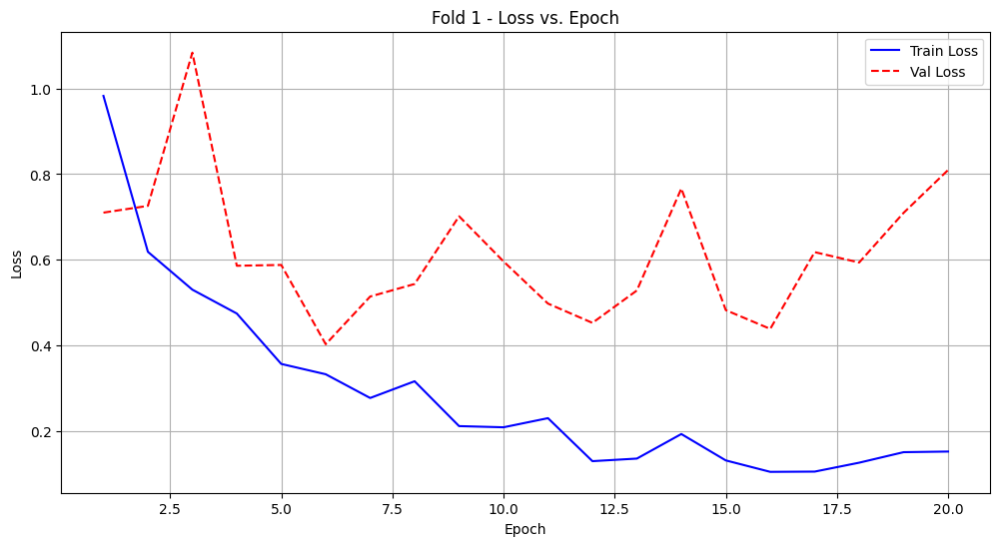

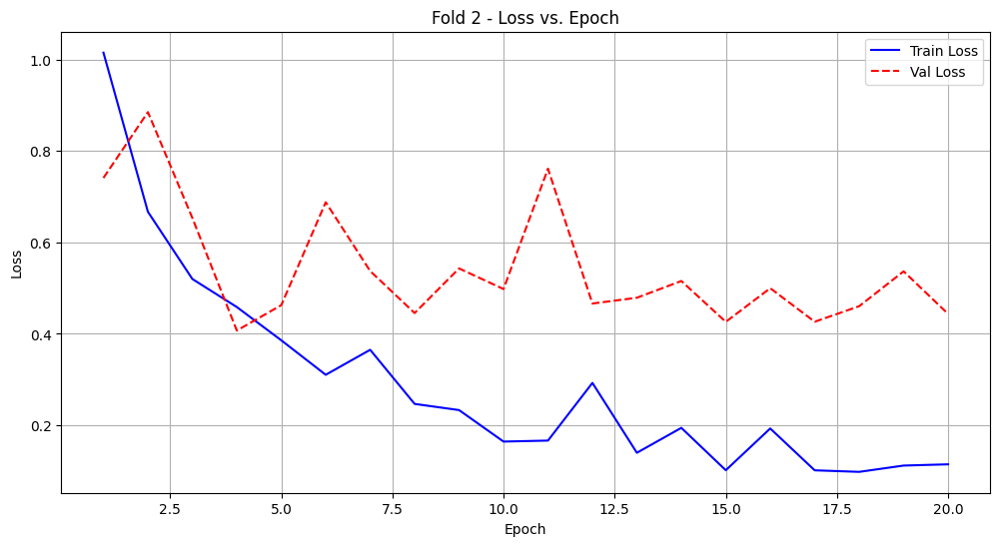

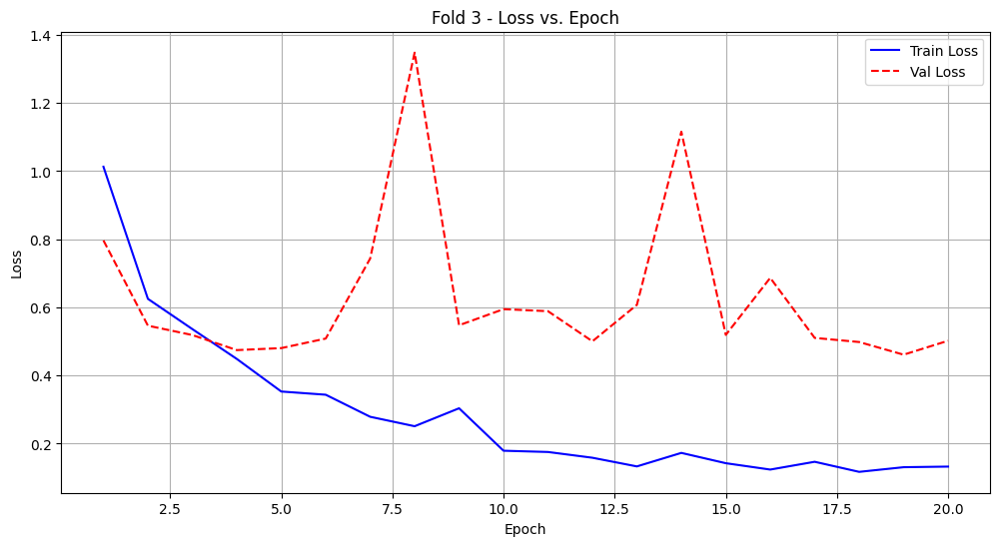

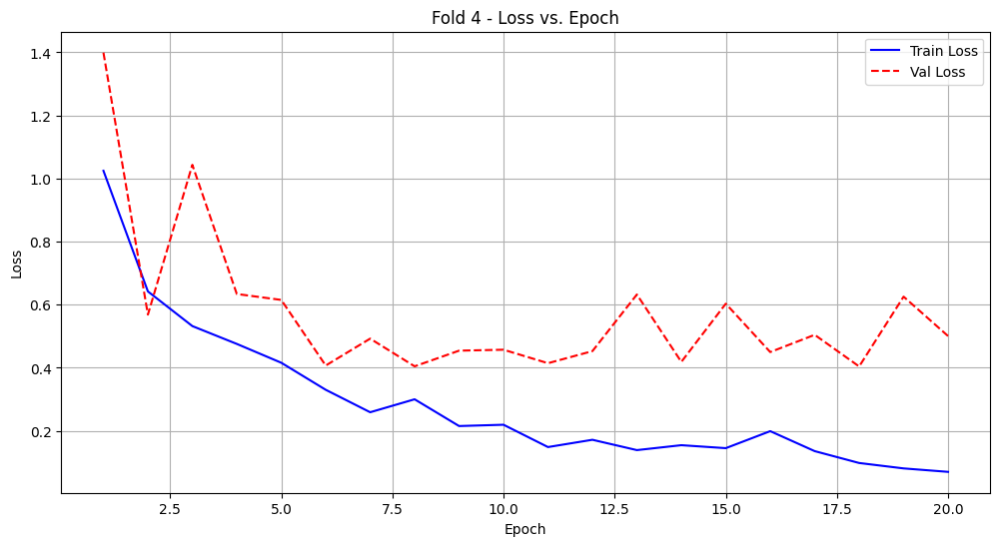

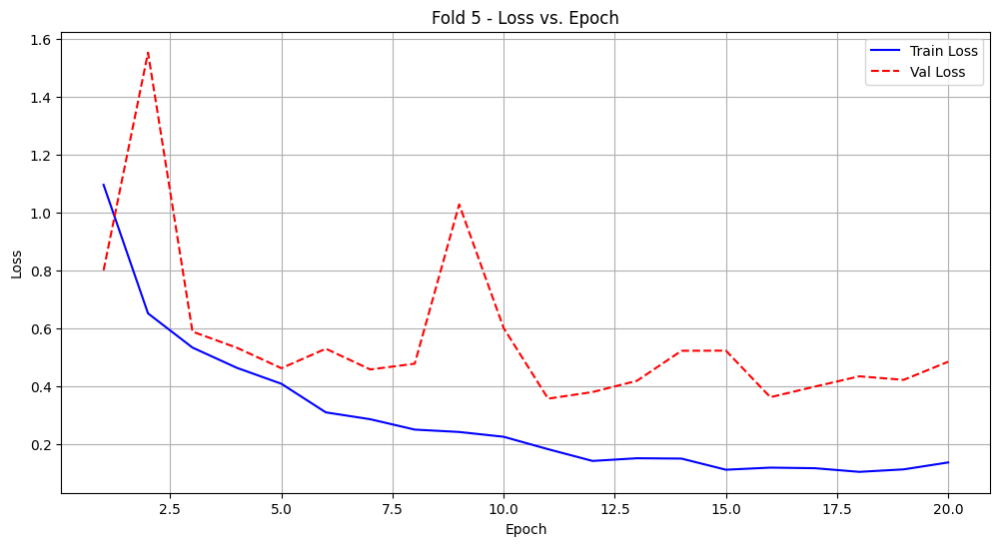

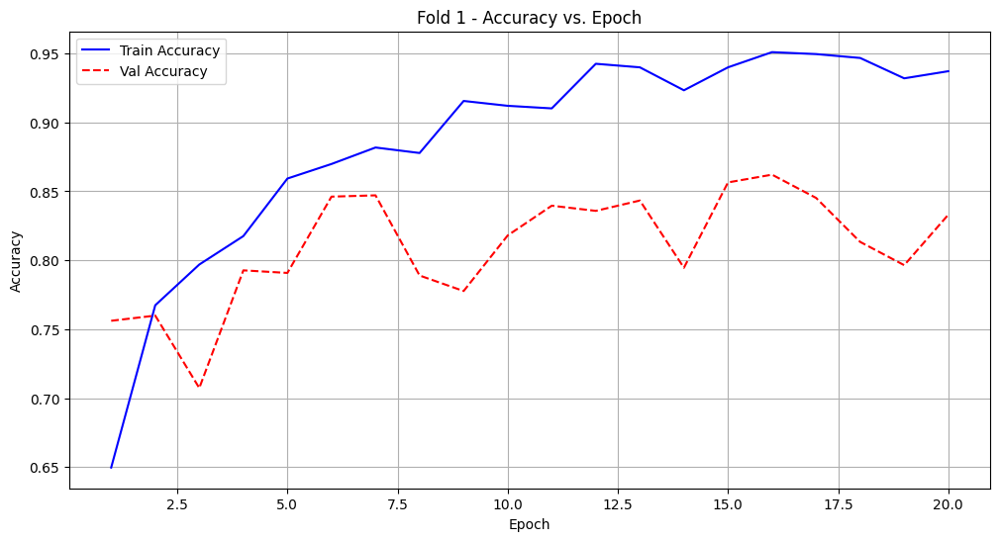

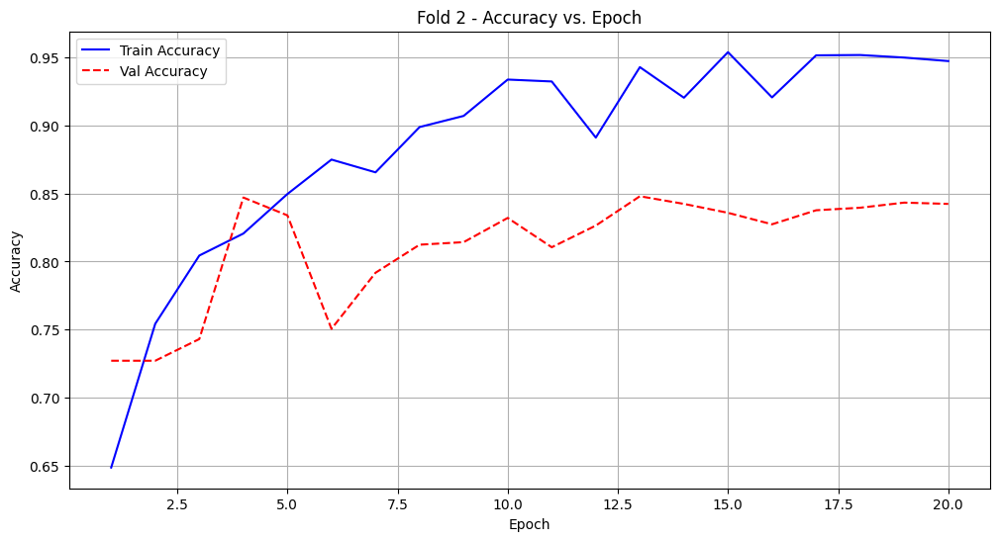

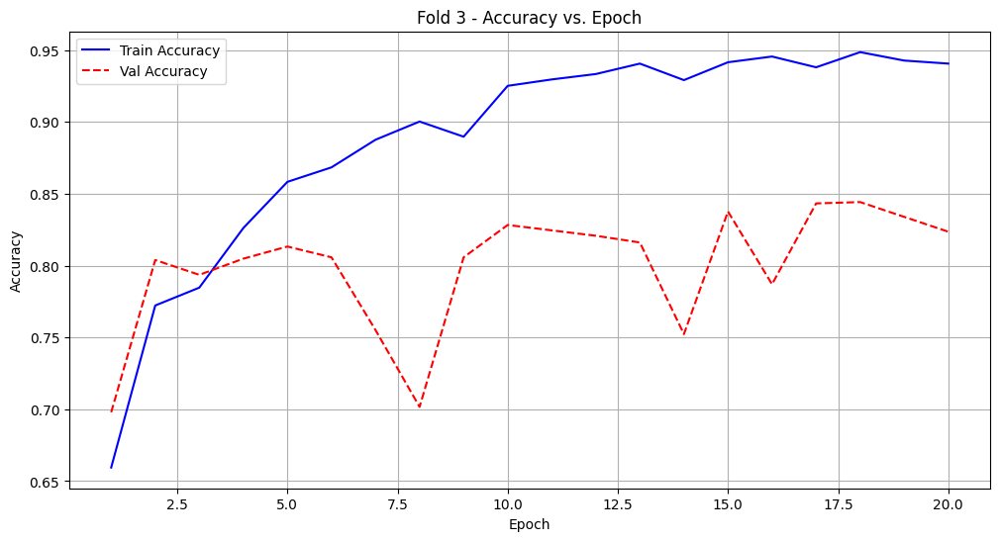

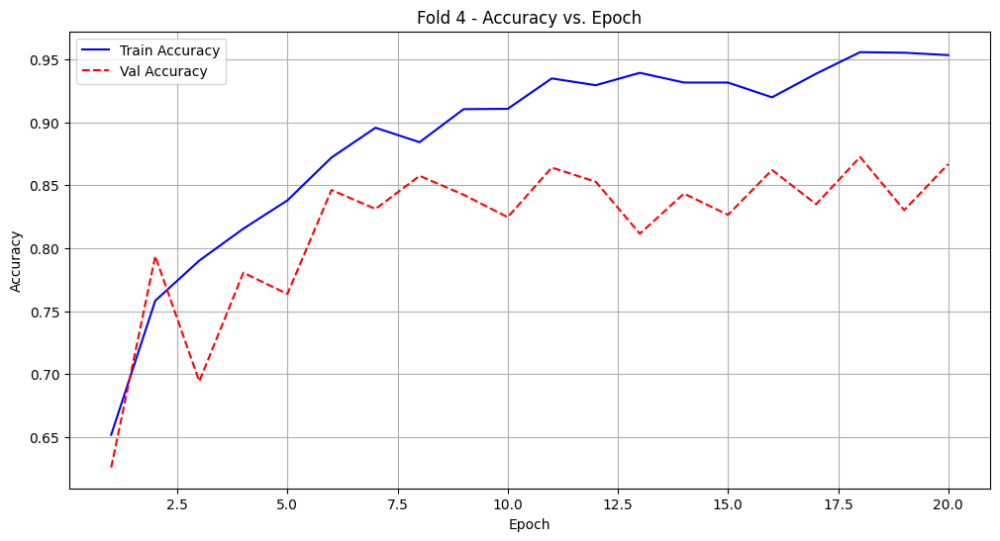

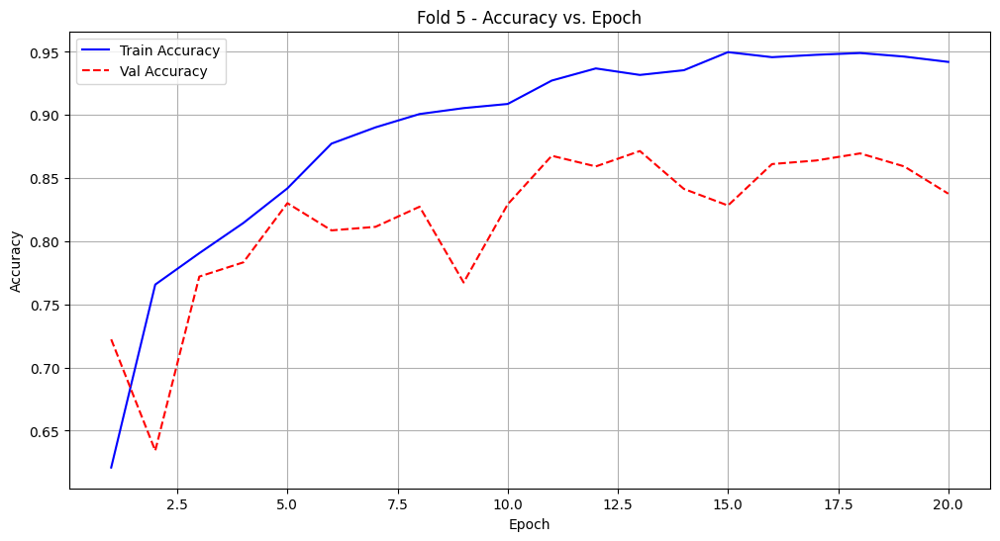

In [ ]:
k=5
for fold in range(k):
    plt.figure(figsize=(12, 6))
    plt.plot(range(1, num_epochs + 1), all_train_losses[fold], label='Train Loss', color='b')
    plt.plot(range(1, num_epochs + 1), all_val_losses[fold], label='Val Loss', color='r', linestyle='--')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title(f'Fold {fold + 1} - Loss vs. Epoch')
    plt.legend()
    plt.grid(True)
    plt.show()

for fold in range(k):
    plt.figure(figsize=(12, 6))
    plt.plot(range(1, num_epochs + 1), all_train_accuracies[fold], label='Train Accuracy', color='b')
    plt.plot(range(1, num_epochs + 1), all_val_accuracies[fold], label='Val Accuracy', color='r', linestyle='--')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title(f'Fold {fold + 1} - Accuracy vs. Epoch')
    plt.legend()
    plt.grid(True)
    plt.show()

In [22]:
model.load_state_dict(torch.load('best_model_fold_5.pth'))
all_labels, all_preds = evaluate_model(model, val_loaders[4])

Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7578.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7557.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7631.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7116.JPG: broken data stream when reading image file


In [51]:
all_labels

array([1, 4, 2, ..., 4, 7, 8])

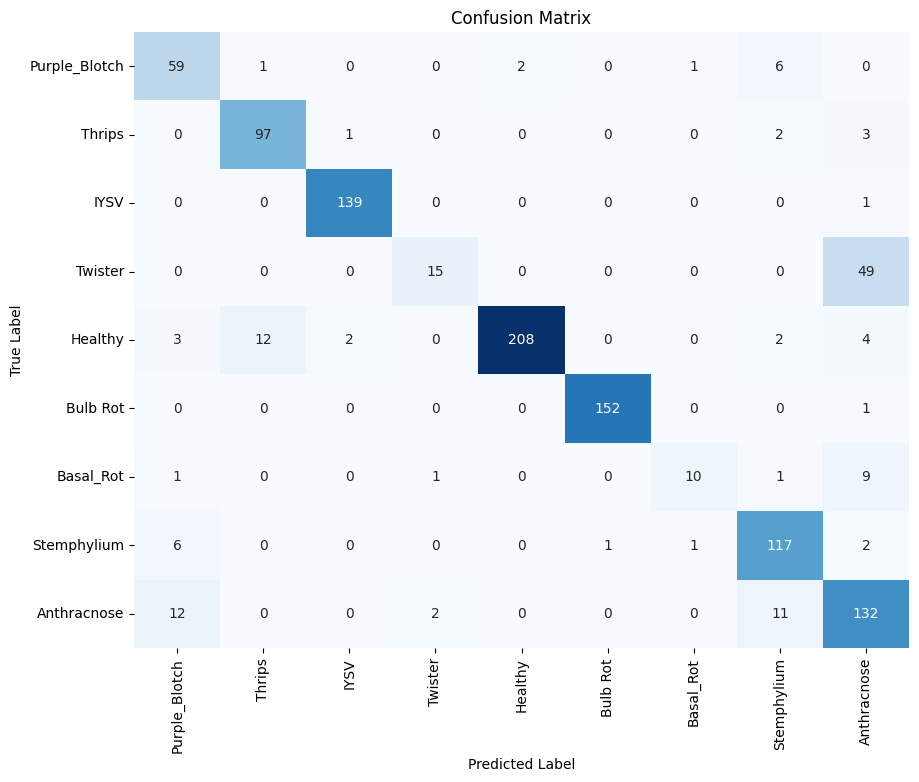

In [23]:
cm = confusion_matrix(all_labels, all_preds)
plot_confusion_matrix(cm, num_classes=len(jpg_paths_dict))

In [ ]:
import numpy as np
from sklearn.metrics import confusion_matrix

def calculate_per_class_accuracy(all_labels, all_preds, class_names):
    cm = confusion_matrix(all_labels, all_preds)
    
    per_class_accuracy = {}
    
    for i, class_name in enumerate(class_names):
        true_positive = cm[i, i]  
        total_true = np.sum(cm[i, :])  
        
        if total_true > 0:
            accuracy = true_positive / total_true
        else:
            accuracy = 0.0
        
        per_class_accuracy[class_name] = accuracy
    
    return per_class_accuracy


In [25]:
print(len(all_preds))
per_class_accuracy = calculate_per_class_accuracy(all_labels, all_preds, class_names)

for class_name, accuracy in per_class_accuracy.items():
    print(f'Class: {class_name}, Accuracy: {accuracy:.4f}')

1066
Class: Purple_Blotch, Accuracy: 0.8551
Class: Thrips, Accuracy: 0.9417
Class: IYSV, Accuracy: 0.9929
Class: Twister, Accuracy: 0.2344
Class: Healthy, Accuracy: 0.9004
Class: Bulb Rot, Accuracy: 0.9935
Class: Basal_Rot, Accuracy: 0.4545
Class: Stemphylium, Accuracy: 0.9213
Class: Anthracnose, Accuracy: 0.8408


In [ ]:
import torch
from torchviz import make_dot

dummy_input = torch.randn(1, 3, 224, 224).to(device)
model1 = models.resnet50(pretrained=True)
num_classes = len(jpg_paths_dict)
model1.fc = nn.Linear(model1.fc.in_features, num_classes)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model1.to(device)
from torchsummary import summary
summary(model1, input_size=(3, 224, 224), device='cuda' if torch.cuda.is_available() else 'cpu')

    

/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          16,384
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
import torch
import torch.nn as nn
from torchvision import models

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model1 = models.resnet50(pretrained=True)
num_classes = 9  
model1.fc = nn.Linear(model1.fc.in_features, num_classes)
model1.to(device)

dummy_input = torch.randn(1, 3, 224, 224).to(device)

onnx_filename = 'resnet50_model.onnx'
torch.onnx.export(model1, dummy_input, onnx_filename, 
                  input_names=['input'], 
                  output_names=['output'],
                  export_params=True, 
                  opset_version=11)


============= Diagnostic Run torch.onnx.export version 2.0.1+cu117 =============
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



# DenseNet 121


In [11]:

train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=64)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False, num_workers=64)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models

model = models.densenet121(pretrained=True)

num_classes = len(jpg_paths_dict)

model.classifier = nn.Linear(model.classifier.in_features, num_classes)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

optimizer = optim.Adam(model.parameters(), lr=0.001)


/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [13]:
print(device)

cuda


In [14]:

import numpy as np
import torch
class_counts = []
for subfolder, jpg_files in jpg_paths_dict.items():
    class_counts.append(len(jpg_files))
def compute_class_weights(label_map, dataset):
    print(class_counts)
    class_weights = np.max(class_counts) / class_counts
    class_weights = torch.tensor(class_weights, dtype=torch.float).to(device)
    print(class_weights)
    return class_weights

class_weights = compute_class_weights(dataset.label_map, dataset)
criterion = nn.CrossEntropyLoss(weight=class_weights)
optimizer = optim.Adam(model.parameters(), lr=0.001)


[406, 546, 754, 317, 1072, 669, 140, 661, 765]
tensor([2.6404, 1.9634, 1.4218, 3.3817, 1.0000, 1.6024, 7.6571, 1.6218, 1.4013],
       device='cuda:0')


In [ ]:
def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=5):
    best_acc = 0.0
    
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        corrects = 0
        total = 0

        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * inputs.size(0)

            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            corrects += (predicted == labels).sum().item()

        epoch_loss = running_loss / len(train_loader.dataset)
        epoch_acc = corrects / total

        model.eval()
        val_running_loss = 0.0
        val_corrects = 0
        val_total = 0

        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                
                val_running_loss += loss.item() * inputs.size(0)
                
                _, predicted = torch.max(outputs, 1)
                val_total += labels.size(0)
                val_corrects += (predicted == labels).sum().item()

        val_loss = val_running_loss / len(val_loader.dataset)
        val_acc = val_corrects / val_total

        train_losses.append(epoch_loss)
        val_losses.append(val_loss)
        train_accuracies.append(epoch_acc)
        val_accuracies.append(val_acc)

        print(f'Epoch {epoch + 1}/{num_epochs} '
              f'Train Loss: {epoch_loss:.4f} Train Accuracy: {epoch_acc:.4f} '
              f'Val Loss: {val_loss:.4f} Val Accuracy: {val_acc:.4f}')

        if val_acc > best_acc:
            best_acc = val_acc
            torch.save(model.state_dict(), 'model_densenet121.pth')
            print(f'Saved best model with accuracy: {best_acc:.4f}')

    print('Training complete.')
    print(f'Best Validation Accuracy: {best_acc:.4f}')
    return train_losses, val_losses, train_accuracies, val_accuracies



train_losses, val_losses, train_accuracies, val_accuracies = train_model(model, train_loader, val_loader, criterion , optimizer, num_epochs=20)


Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7182.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7113.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7698.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7116.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7578.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7118.JPG: broken data stream when reading image file
Error loading image /raid/ee-mariyam/maryam/abhijeet

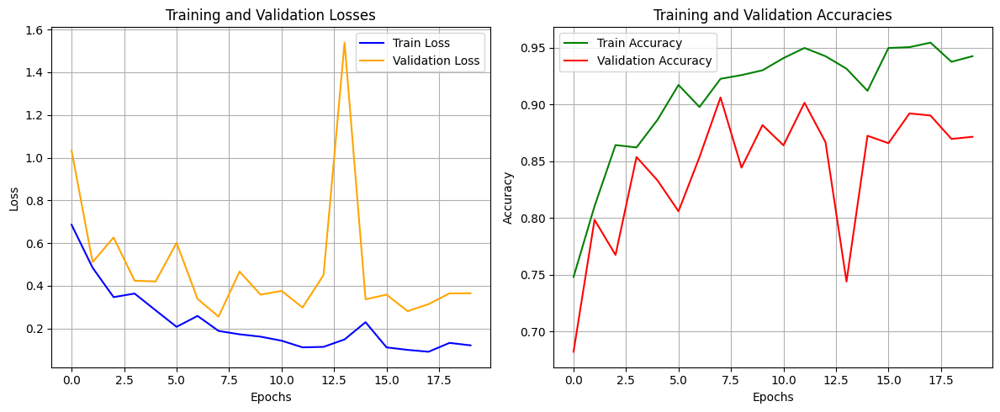

In [ ]:
import matplotlib.pyplot as plt

def plot_losses(train_losses, val_losses):
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1) 
    plt.plot(train_losses, label='Train Loss', color='blue')
    plt.plot(val_losses, label='Validation Loss', color='orange')
    plt.title('Training and Validation Losses')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()

def plot_accuracies(train_accuracies, val_accuracies):
    plt.subplot(1, 2, 2) 
    plt.plot(train_accuracies, label='Train Accuracy', color='green')
    plt.plot(val_accuracies, label='Validation Accuracy', color='red')
    plt.title('Training and Validation Accuracies')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid()

plot_losses(train_losses, val_losses)
plot_accuracies(train_accuracies, val_accuracies)

plt.tight_layout()
plt.show()


In [15]:
model.load_state_dict(torch.load('model_densenet121.pth'))
all_labels, all_preds = evaluate_model(model, val_loader)

<All keys matched successfully>

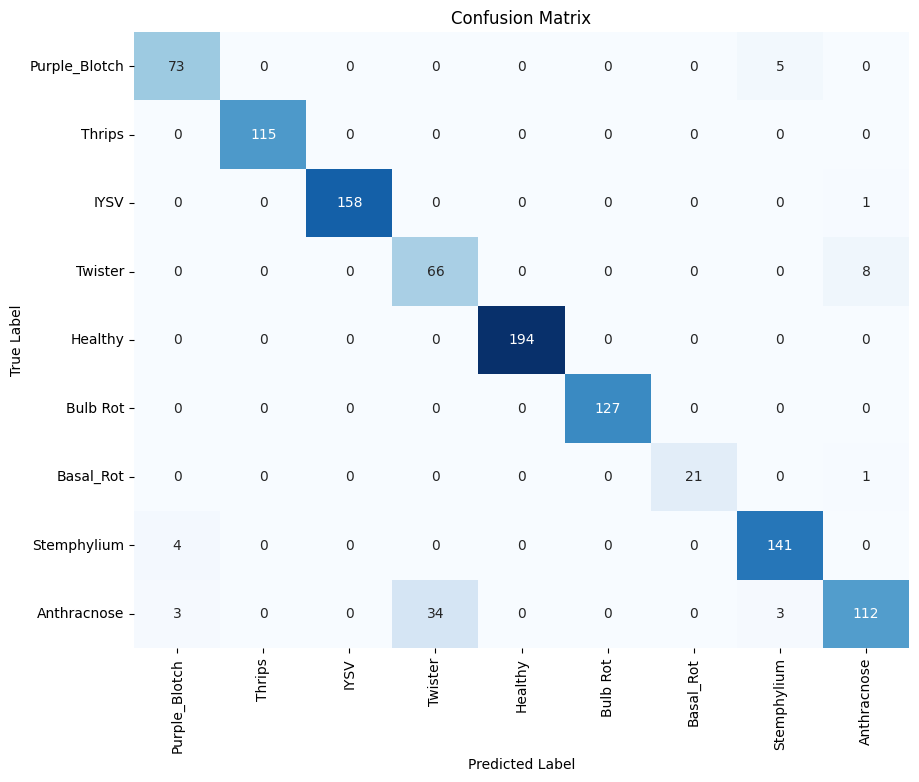

In [34]:
cm = confusion_matrix(all_labels, all_preds)
plot_confusion_matrix(cm, num_classes=len(jpg_paths_dict))

Total Accuracy: 94.47%
Class 'Purple_Blotch' Accuracy: 93.59%
Class 'Thrips' Accuracy: 100.00%
Class 'IYSV' Accuracy: 99.37%
Class 'Twister' Accuracy: 89.19%
Class 'Healthy' Accuracy: 100.00%
Class 'Bulb Rot' Accuracy: 100.00%
Class 'Basal_Rot' Accuracy: 95.45%
Class 'Stemphylium' Accuracy: 97.24%
Class 'Anthracnose' Accuracy: 73.68%


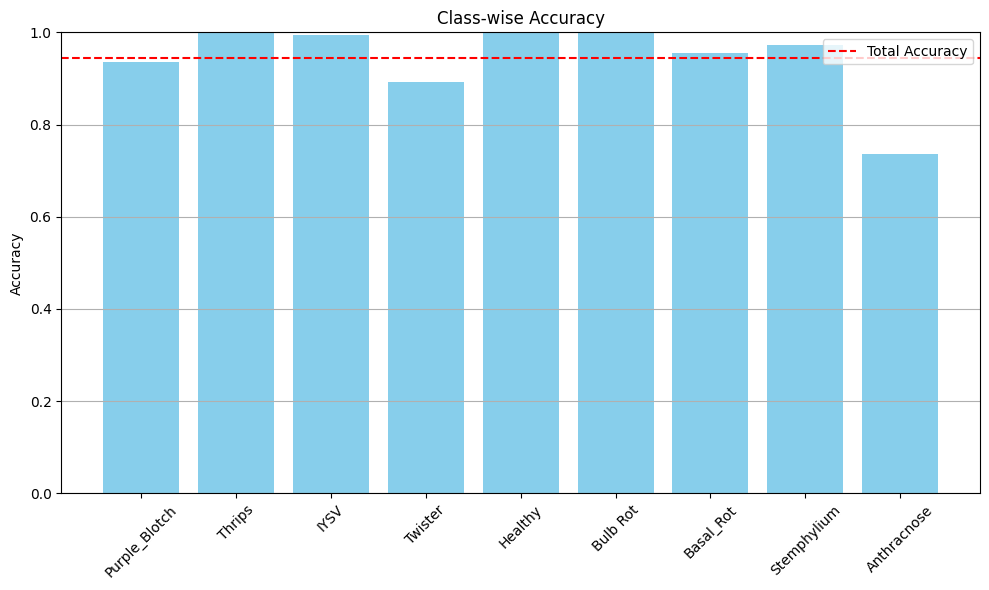

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


total_accuracy = np.trace(cm) / np.sum(cm)

classwise_accuracy = cm.diagonal() / cm.sum(axis=1)

class_names = list(jpg_paths_dict.keys())  
classwise_accuracy = [
    acc if cm.sum(axis=1)[i] > 0 else np.nan
    for i, acc in enumerate(classwise_accuracy)
]

print(f"Total Accuracy: {total_accuracy * 100:.2f}%")
for i, accuracy in enumerate(classwise_accuracy):
    if np.isnan(accuracy):
        print(f"Class '{class_names[i]}' Accuracy: N/A (no samples)")
    else:
        print(f"Class '{class_names[i]}' Accuracy: {accuracy * 100:.2f}%")

plt.figure(figsize=(10, 6))
plt.bar(class_names, classwise_accuracy, color='skyblue')
plt.ylabel('Accuracy')
plt.title('Class-wise Accuracy')
plt.ylim(0, 1)  
plt.axhline(total_accuracy, color='red', linestyle='--', label='Total Accuracy')
plt.xticks(rotation=45)  
plt.legend()
plt.grid(axis='y')
plt.tight_layout()  
plt.show()


# Open Set Implementation on DenseNet121

# GradCAM analysis of DenseNet121 

In [ ]:
class GradCAM:
    def __init__(self, model):
        self.model = model
        self.gradients = None
        self.feature_maps = None
        
        self.model.features[-1].register_forward_hook(self.save_feature_maps)
        self.model.features[-1].register_backward_hook(self.save_gradients)

    def save_feature_maps(self, module, input, output):
        self.feature_maps = output

    def save_gradients(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def generate_cam(self, input_tensor):
        output = self.model(input_tensor)
        class_idx = output.argmax().item()

        self.model.zero_grad()

        output[0][class_idx].backward()

        weights = self.gradients.mean(dim=[0, 2, 3], keepdim=True)
        cam = (weights * self.feature_maps).sum(dim=1, keepdim=True)

        cam = F.relu(cam)
        cam = cam / cam.max()  
        return cam


In [ ]:
def get_sample_images(val_loader, num_classes):
    samples = []
    class_indices = {i: False for i in range(num_classes)}  
    for inputs, labels in val_loader:
        for idx, label in enumerate(labels):
            if not class_indices[label.item()]:  
                samples.append((inputs[idx], label))  
                class_indices[label.item()] = True 
            if all(class_indices.values()): 
                return samples  
    return samples  


In [ ]:
def visualize_gradcam(samples, model, device, class_names, threshold=0.2):
    gradcam = GradCAM(model)

    for image, label in samples:
        image = image.unsqueeze(0).to(device)  
        cam = gradcam.generate_cam(image)

        cam = cam.squeeze().cpu().detach().numpy()
        cam = cv2.resize(cam, (image.shape[2], image.shape[3]))  
        
        cam = cam - np.min(cam)
        cam = cam / np.max(cam)  
        
        cam[cam < threshold] = 0 

        original_image = image.squeeze().cpu().detach().numpy().transpose(1, 2, 0)
        original_image = (original_image - original_image.min()) / (original_image.max() - original_image.min()) 
        heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
        heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
        original_image_bgr = (original_image * 255).astype(np.uint8)
        
        alpha = 0.6  
        beta = 0.4   
        superimposed_img = cv2.addWeighted(original_image_bgr, beta, heatmap, alpha, 0) 

        original_image_pil = Image.fromarray((original_image * 255).astype(np.uint8))
        heatmap_pil = Image.fromarray(heatmap)
        superimposed_img_pil = Image.fromarray(superimposed_img)

        model.eval()
        with torch.no_grad():
            outputs = model(image)
            _, predicted_label = torch.max(outputs, 1)

        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.imshow(original_image_pil)
        plt.title(f'Original Image\nActual: {class_names[label]}\nPredicted: {class_names[predicted_label.item()]}')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(heatmap_pil, alpha=0.5)
        plt.title('Grad-CAM Heatmap (Thresholded)')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(superimposed_img_pil)
        plt.title('Superimposed Image (Thresholded)')
        plt.axis('off')

        plt.show()

In [ ]:
num_classes = len(jpg_paths_dict) 
class_names = list(jpg_paths_dict.keys())  

sample_images = get_sample_images(val_loader, num_classes)

Error loading image /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7116.JPG: broken data stream when reading image file


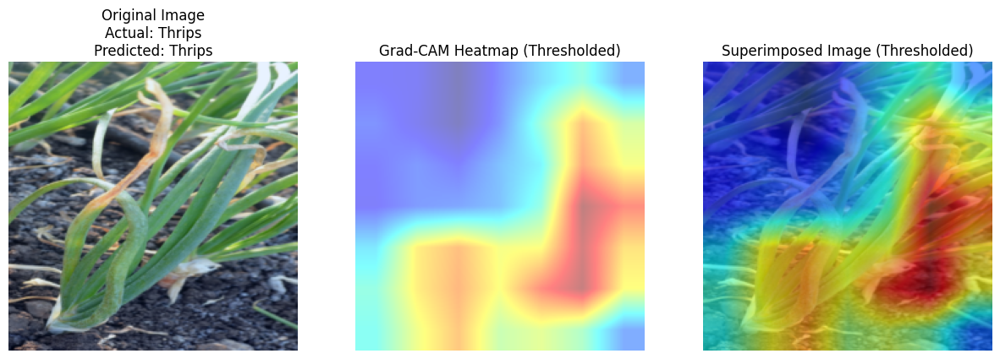

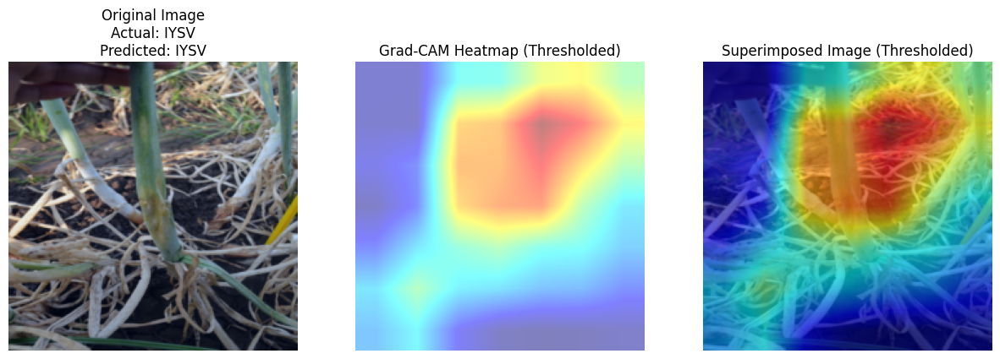

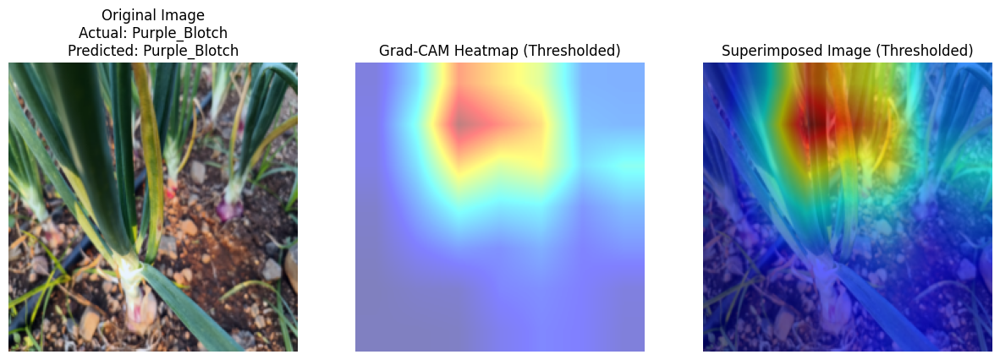

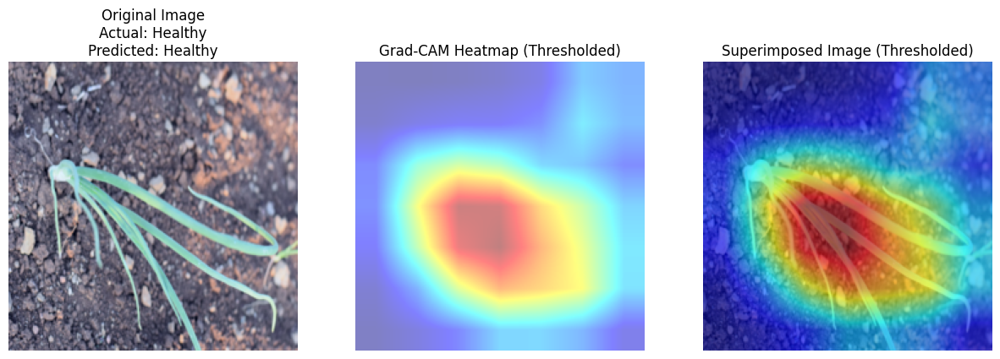

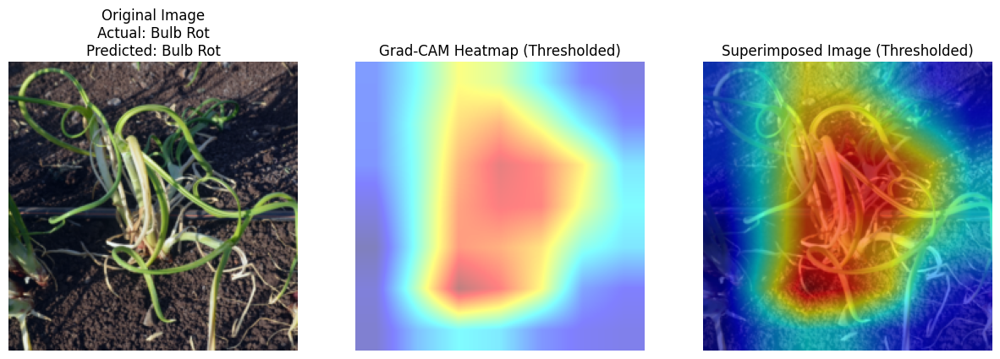

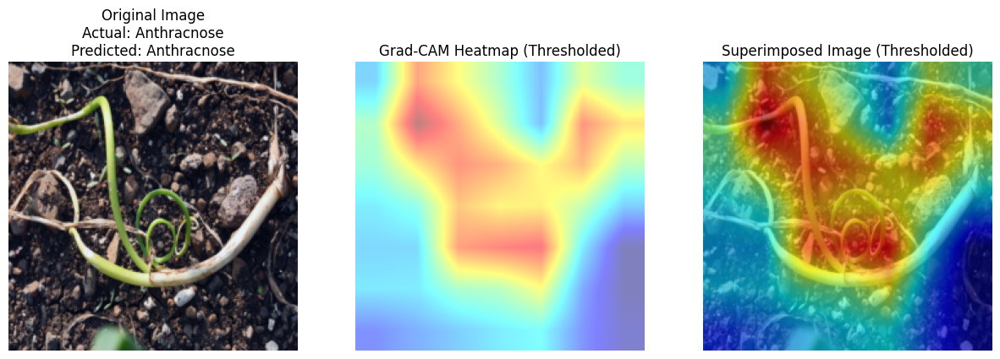

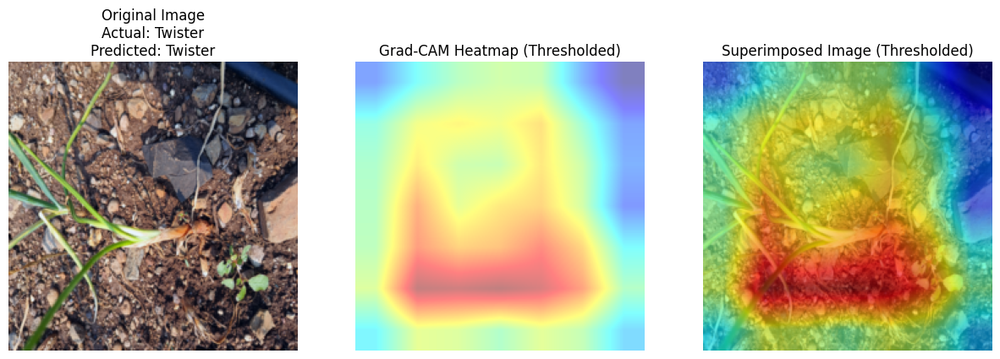

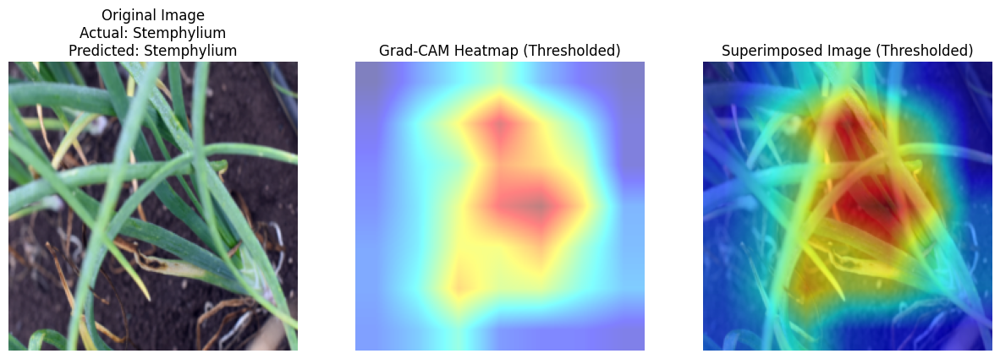

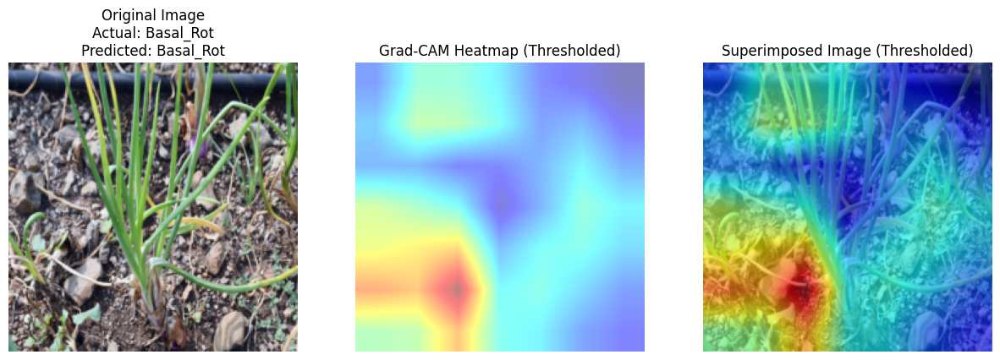

In [ ]:
visualize_gradcam(sample_images, model, device, class_names, threshold=0)  

In [ ]:
def get_sample_images(val_loader, num_classes, samples_per_class=10):
    samples = []
    class_indices = {i: [] for i in range(num_classes)}  

    for inputs, labels in val_loader:
        for idx, label in enumerate(labels):
            class_label = label.item()
            if len(class_indices[class_label]) < samples_per_class: 
                class_indices[class_label].append((inputs[idx], label)) 
            if all(len(class_indices[i]) >= samples_per_class for i in range(num_classes)):  
                return [sample for class_samples in class_indices.values() for sample in class_samples]

    return [sample for class_samples in class_indices.values() for sample in class_samples]


In [ ]:
import numpy as np
import cv2
import torch
import matplotlib.pyplot as plt
from PIL import Image

def visualize_gradcam(samples, model, device, class_names, threshold=0.2):
    gradcam = GradCAM(model)

    for sample in samples:
        image, label = sample 
        image = image.unsqueeze(0).to(device)

        cam = gradcam.generate_cam(image)

        cam = cam.squeeze().cpu().detach().numpy()
        cam = cv2.resize(cam, (image.shape[3], image.shape[2]))  
        cam = (cam - np.min(cam)) / (np.max(cam) - np.min(cam) + 1e-8)  

        cam[cam < threshold] = 0  

        original_image = image.squeeze().cpu().detach().numpy().transpose(1, 2, 0)
        original_image = (original_image - original_image.min()) / (original_image.max() - original_image.min() + 1e-8) 

        heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
        heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)

        original_image_bgr = (original_image * 255).astype(np.uint8)

        alpha = 0.6 
        beta = 0.4   
        superimposed_img = cv2.addWeighted(original_image_bgr, beta, heatmap, alpha, 0)  

        original_image_pil = Image.fromarray((original_image * 255).astype(np.uint8))
        heatmap_pil = Image.fromarray(heatmap)
        superimposed_img_pil = Image.fromarray(superimposed_img)

        model.eval()
        with torch.no_grad():
            outputs = model(image)
            _, predicted_label = torch.max(outputs, 1)

        actual_label = label.item()  
        predicted_label_value = predicted_label.item()

        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.imshow(original_image_pil)
        plt.title(f'Original Image\nActual: {class_names[actual_label]}\nPredicted: {class_names[predicted_label_value]}')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(heatmap_pil, alpha=0.5)
        plt.title('Grad-CAM Heatmap (Thresholded)')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(superimposed_img_pil)
        plt.title('Superimposed Image (Thresholded)')
        plt.axis('off')

        plt.show()


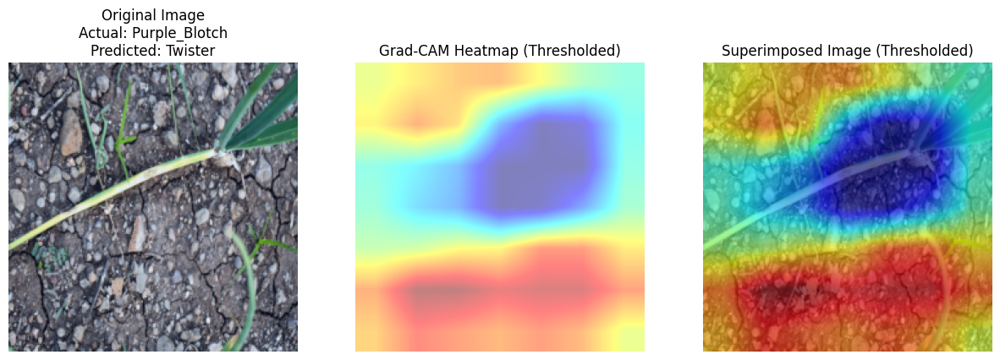

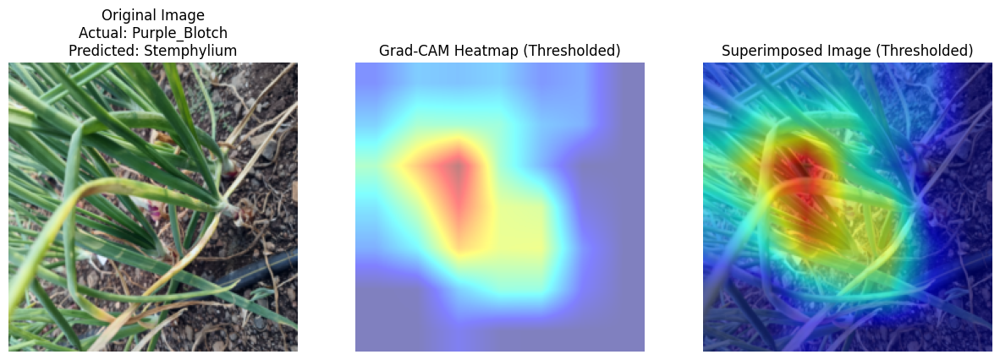

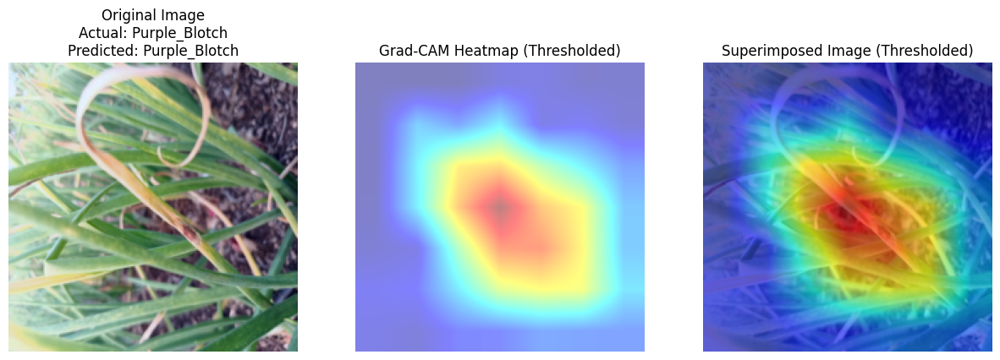

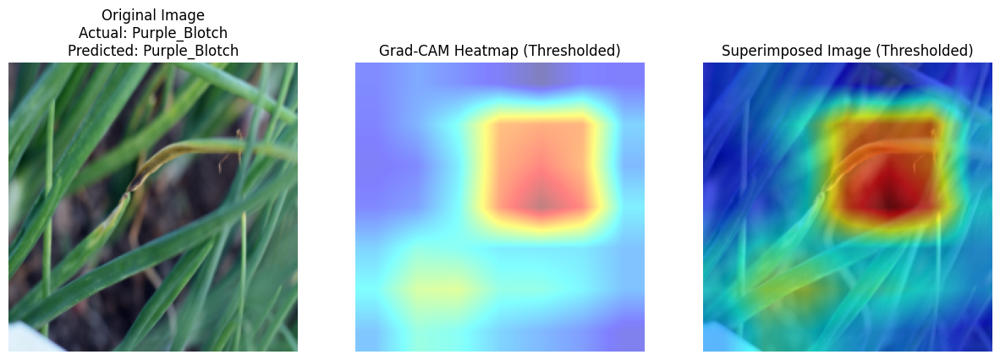

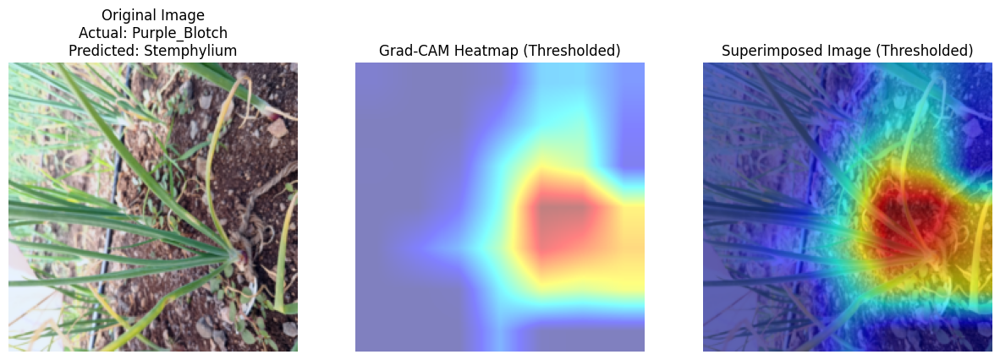

...

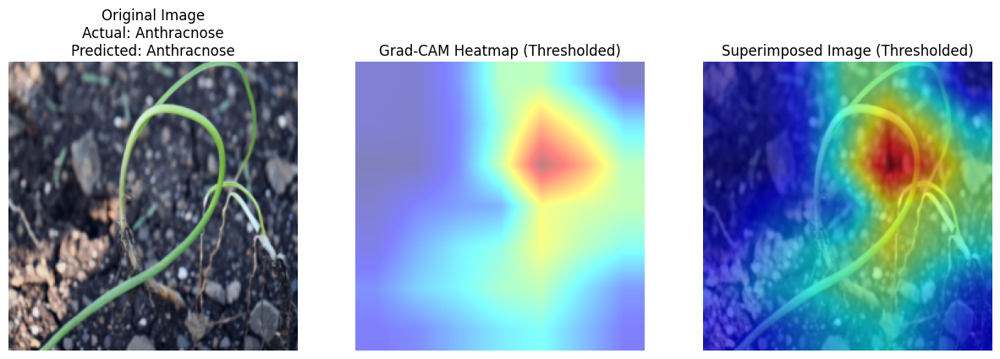

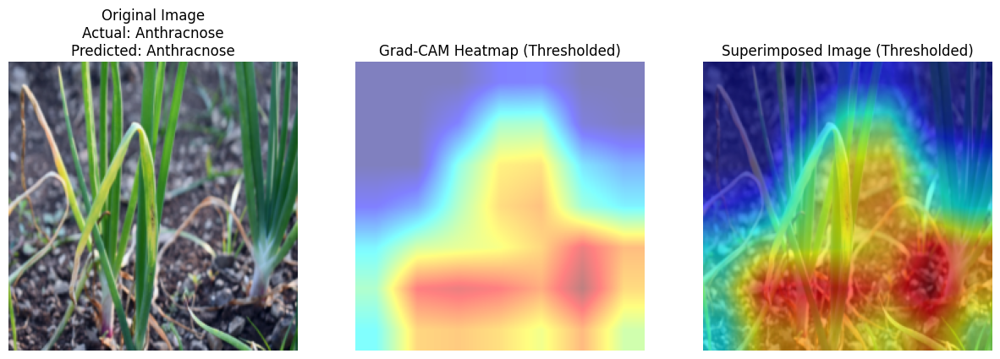

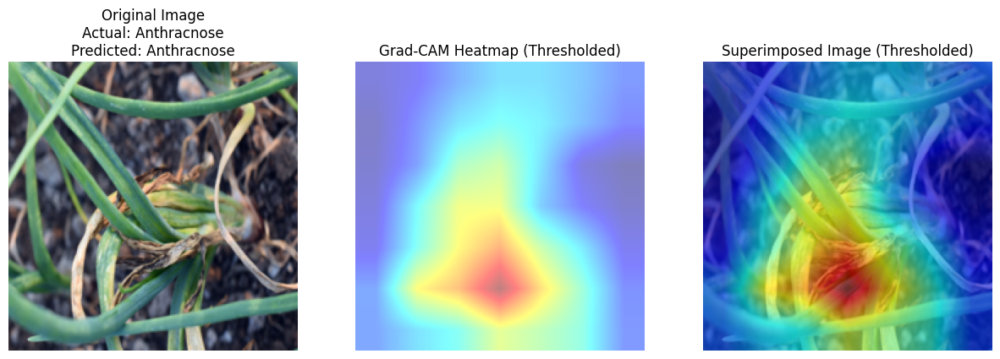

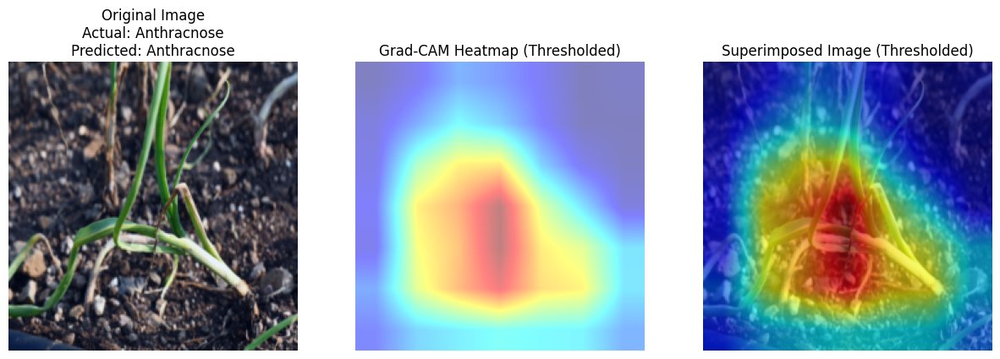

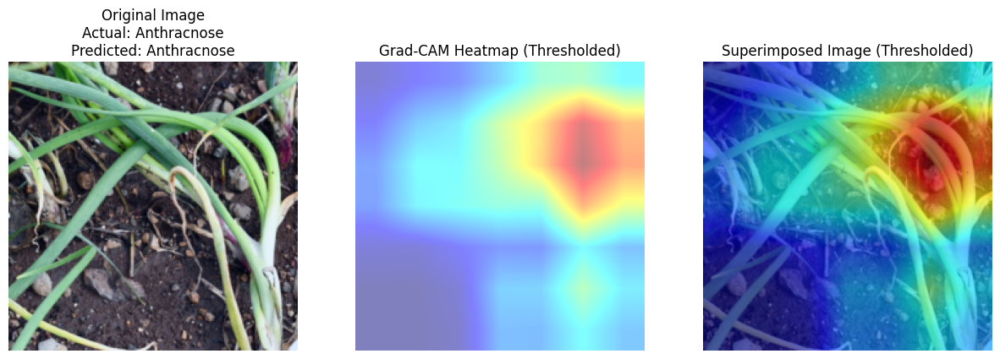

In [ ]:
sample_images = get_sample_images(val_loader, num_classes, samples_per_class=5)

original_class_names = dataset.label_map

class_names = {value: key for key, value in original_class_names.items()}
visualize_gradcam(sample_images, model, device, class_names, threshold=0)

# Using Sampler Now instead of Weighted Cross Entropy


# ResNet50

In [ ]:
import glob
import shutil
from numpy import random
import os

broken_images = [
    "PB_D_E6_18_11_2023_DSC_7113.JPG",
    "PB_D_E6_18_11_2023_DSC_7182.JPG",
    "PB_D_E6_21_11_2023_DSC_7557.JPG",
    "PB_D_E6_21_11_2023_DSC_7631.JPG",
    "PB_D_E6_21_11_2023_DSC_7578.JPG",
    "PB_D_E6_18_11_2023_DSC_7116.JPG",
    "PB_D_E6_18_11_2023_DSC_7118.JPG",
    "PB_D_E6_21_11_2023_DSC_7698.JPG"
]

folders = glob.glob("/raid/ee-mariyam/maryam/abhijeet/Combined_Files/*")
file_list = []
labels = []

for folder in folders:
    dest = os.path.basename(folder)
    files = glob.glob(os.path.join(folder, "**", "*"), recursive=True) 
    dest = os.path.basename(folder)
    length = len(files)
    
    random.shuffle(files)
    
    for i, filename in enumerate(files):
        if filename.lower().endswith('.jpg'):
            if os.path.basename(filename) in broken_images:
                print(f"Skipping broken image: {filename}")
                continue  
            file_list.append(filename)
            labels.append(dest)
X_train, X_val, y_train, y_val = train_test_split(
    file_list,
    labels,
    test_size=0.2,  
    stratify=labels,  
    random_state=42   
)

count = 0
for filename, label in zip(X_train, y_train):
    count+=1
    os.makedirs(os.path.join(train_dir, label), exist_ok=True)
    shutil.copy(filename, os.path.join(train_dir, label))

for filename, label in zip(X_val, y_val):
    count+=1
    os.makedirs(os.path.join(val_dir, label), exist_ok=True)
    shutil.copy(filename, os.path.join(val_dir, label))

print(count)


Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7578.JPG
Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7631.JPG
Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7116.JPG
Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7118.JPG
Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7698.JPG
Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7182.JPG
Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_21_11_2023_DSC_7557.JPG
Skipping broken image: /raid/ee-mariyam/maryam/abhijeet/Combined_Files/Purple_Blotch/PB_D_E6_18_11_2023_DSC_7113.JPG
5322


In [ ]:
import os

def count_jpg_files(base_dir):
    count = 0
    for root, dirs, files in os.walk(base_dir):
        for file in files:
            if file.lower().endswith('.jpg'): 
                count += 1
    return count

folder_path = "/raid/ee-mariyam/maryam/abhijeet/Siddhart"

num_jpg_files = count_jpg_files(folder_path)

print(f"Total number of .jpg files in the folder: {num_jpg_files}")


Total number of .jpg files in the folder: 5322


In [ ]:
import torch
data_dir = '/raid/ee-mariyam/maryam/abhijeet/Siddhart'
train_dir = data_dir + '/train'
valid_dir = data_dir + '/val'
nThreads = 4
batch_size = 16
use_gpu = torch.cuda.is_available()

data_transforms = {
    'train': transforms.Compose([
        transforms.RandomRotation(30),
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

In [ ]:
from torchsampler import ImbalancedDatasetSampler


num_workers = 32  

image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x]) for x in ['train', 'val']}

dataloaders = {
    x: torch.utils.data.DataLoader(
        image_datasets[x],
        batch_size=batch_size,
        num_workers=num_workers  
    ) if x == 'val' else torch.utils.data.DataLoader(
        image_datasets[x],
        sampler=ImbalancedDatasetSampler(image_datasets[x]),
        batch_size=batch_size,
        num_workers=num_workers 
    ) for x in ['train', 'val']
}

dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_names = image_datasets['train'].classes


In [ ]:
from collections import Counter
import torch

def count_classwise_images(dataloader):
    class_counts = Counter()
    for images, labels in dataloader:
        class_counts.update(labels.numpy()) 
    return class_counts

train_class_counts = count_classwise_images(dataloaders['train'])
val_class_counts = count_classwise_images(dataloaders['val'])

print("Class-wise number of images in the training set:")
for cls, count in train_class_counts.items():
    print(f"Class {cls}: {count}")

print("\nClass-wise number of images in the validation set:")
for cls, count in val_class_counts.items():
    print(f"Class {cls}: {count}")


Class-wise number of images in the training set:
Class 3: 512
Class 7: 500
Class 2: 465
Class 0: 515
Class 8: 476
Class 1: 465
Class 5: 442
Class 6: 448
Class 4: 434

Class-wise number of images in the validation set:
Class 0: 153
Class 1: 28
Class 2: 134
Class 3: 215
Class 4: 151
Class 5: 80
Class 6: 132
Class 7: 109
Class 8: 63


Mapped Train Class Counts: {'Anthracnose': 515, 'Basal_Rot': 465, 'Bulb Rot': 465, 'Healthy': 512, 'IYSV': 434, 'Purple_Blotch': 442, 'Stemphylium': 448, 'Thrips': 500, 'Twister': 476}
Mapped Validation Class Counts: {'Anthracnose': 153, 'Basal_Rot': 28, 'Bulb Rot': 134, 'Healthy': 215, 'IYSV': 151, 'Purple_Blotch': 80, 'Stemphylium': 132, 'Thrips': 109, 'Twister': 63}


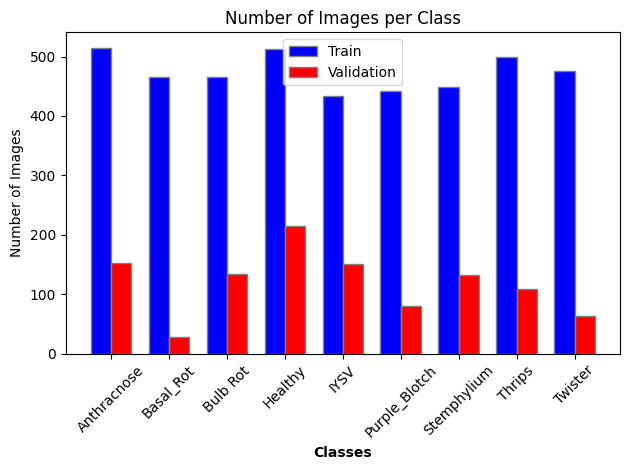

In [ ]:
label_to_class = {i: class_name for i, class_name in enumerate(class_names)}

train_counts = [train_class_counts.get(i, 0) for i in range(len(class_names))]
val_counts = [val_class_counts.get(i, 0) for i in range(len(class_names))]

train_class_counts_mapped = {label_to_class[i]: count for i, count in enumerate(train_counts)}
val_class_counts_mapped = {label_to_class[i]: count for i, count in enumerate(val_counts)}

print("Mapped Train Class Counts:", train_class_counts_mapped)
print("Mapped Validation Class Counts:", val_class_counts_mapped)

bar_width = 0.35


r1 = range(len(class_names))
r2 = [x + bar_width for x in r1]


plt.bar(r1, train_counts, color='b', width=bar_width, edgecolor='grey', label='Train')
plt.bar(r2, val_counts, color='r', width=bar_width, edgecolor='grey', label='Validation')

plt.xlabel('Classes', fontweight='bold')
plt.xticks([r + bar_width / 2 for r in range(len(class_names))], class_names, rotation = 45)
plt.ylabel('Number of Images')
plt.title('Number of Images per Class')
plt.legend()
plt.tight_layout()
plt.show()

In [20]:
print(class_names)

['Anthracnose', 'Basal_Rot', 'Bulb Rot', 'Healthy', 'IYSV', 'Purple_Blotch', 'Stemphylium', 'Thrips', 'Twister']


In [ ]:
import time
import copy


def train_model(model, criterion, optimizer, scheduler, num_epochs=20):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0


    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    for epoch in range(1, num_epochs + 1):
        print('Epoch {}/{}'.format(epoch, num_epochs))
        print('-' * 10)


        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  
            else:
                model.eval() 

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in dataloaders[phase]:
                inputs, labels = inputs.to(device), labels.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    loss = criterion(outputs, labels)
                    _, preds = torch.max(outputs, 1)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            if phase == 'train':
                train_losses.append(epoch_loss)
                train_accuracies.append(epoch_acc.item())
            else:
                val_losses.append(epoch_loss)
                val_accuracies.append(epoch_acc.item())

            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        scheduler.step()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best valid accuracy: {:4f}'.format(best_acc))

    model.load_state_dict(best_model_wts)

    return model, train_losses, val_losses, train_accuracies, val_accuracies


In [ ]:

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models

model = models.resnet50(pretrained=True)
num_classes = 9
model.fc = nn.Linear(model.fc.in_features, num_classes)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [27]:
num_epochs = 20
import time
import copy
from torch.optim import lr_scheduler
exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
criterion = nn.CrossEntropyLoss()

model_ft, train_losses, val_losses, train_accuracies, val_accuracies = train_model(
    model, criterion, optimizer, exp_lr_scheduler, num_epochs
)

Epoch 1/20
----------


train Loss: 1.5494 Acc: 0.4332
val Loss: 1.2161 Acc: 0.5690
Epoch 2/20
----------
train Loss: 1.1214 Acc: 0.5847
val Loss: 0.8791 Acc: 0.6732
Epoch 3/20
----------
train Loss: 0.9663 Acc: 0.6293
val Loss: 0.7912 Acc: 0.7183
Epoch 4/20
----------


KeyboardInterrupt: 

In [ ]:
import json


data = {
    'train_losses': train_losses,
    'val_losses': val_losses,
    'train_accuracies': train_accuracies,
    'val_accuracies': val_accuracies
}

with open('resnet50_sampling_losses.json', 'w') as jsonfile:
    json.dump(data, jsonfile, indent=4)

In [18]:
model_path = 'sampling_resnet50'
torch.save(model_ft.state_dict(), model_path)
print(f'Model saved to {model_path}')

Model saved to sampling_resnet50


In [ ]:
model_path = 'sampling_resnet50'
model.load_state_dict(torch.load(model_path))
model.eval()

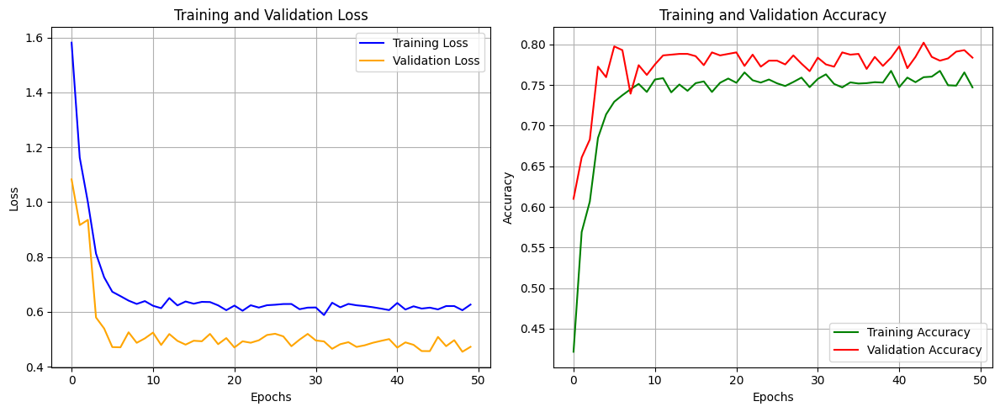

In [15]:
plot_losses_and_accuracies( train_losses, val_losses, train_accuracies, val_accuracies)

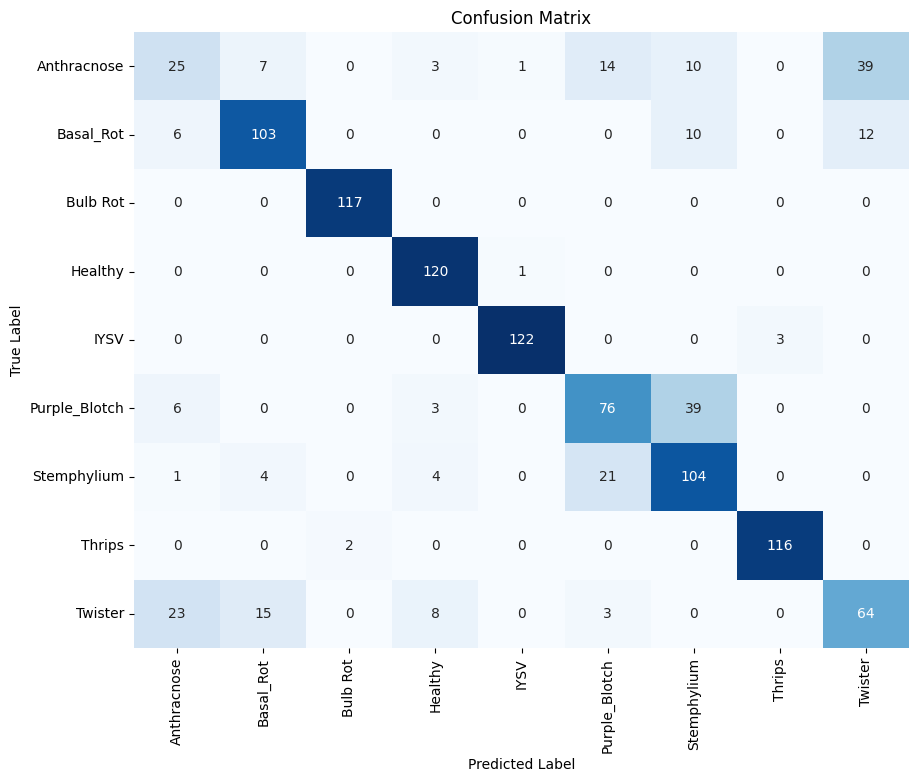

In [16]:
val_labels, val_preds = evaluate_model(model_ft, dataloaders['val'])
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(val_labels, val_preds)
cm_display = plot_confusion_matrix(cm,class_names )


Accuracy for Anthracnose: 0.2525
Accuracy for Basal_Rot: 0.7863
Accuracy for Bulb Rot: 1.0000
Accuracy for Healthy: 0.9917
Accuracy for IYSV: 0.9760
Accuracy for Purple_Blotch: 0.6129
Accuracy for Stemphylium: 0.7761
Accuracy for Thrips: 0.9831
Accuracy for Twister: 0.5664


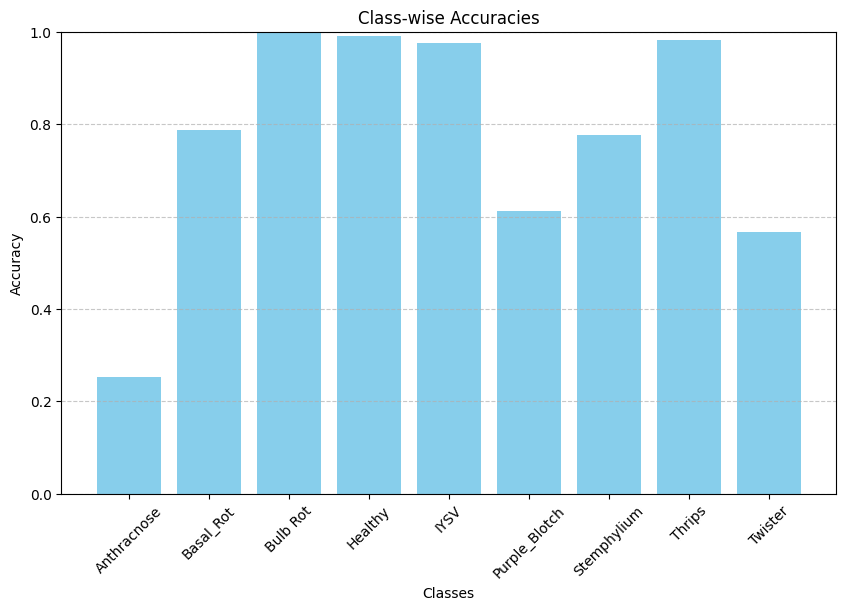

Overall Accuracy: 0.7828


In [ ]:

class_accuracies = cm.diagonal() / cm.sum(axis=1)

for i, class_name in enumerate(class_names):
    print(f'Accuracy for {class_name}: {class_accuracies[i]:.4f}')


plt.figure(figsize=(10, 6))
plt.bar(class_names, class_accuracies, color='skyblue')
plt.xlabel('Classes')
plt.ylabel('Accuracy')
plt.title('Class-wise Accuracies')
plt.xticks(rotation=45)
plt.ylim(0, 1)  
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

total_correct = cm.diagonal().sum()
total_samples = cm.sum()
overall_accuracy = total_correct / total_samples

print(f'Overall Accuracy: {overall_accuracy:.4f}')

# DenseNet121


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models

model = models.densenet121(pretrained=True)
num_classes = 9
model.classifier = nn.Linear(model.classifier.in_features, num_classes)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)
optimizer = optim.Adam(model.parameters(), lr=0.001)


/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/raid/ee-mariyam/maryam/.local/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [21]:
num_epochs = 20
import time
import copy
from torch.optim import lr_scheduler
exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
criterion = nn.CrossEntropyLoss()

model_ft, train_losses, val_losses, train_accuracies, val_accuracies = train_model(
    model, criterion, optimizer, exp_lr_scheduler, num_epochs
)

Epoch 1/20
----------


train Loss: 1.2495 Acc: 0.5505
val Loss: 1.2049 Acc: 0.5989
Epoch 2/20
----------
train Loss: 0.9313 Acc: 0.6502
val Loss: 0.9257 Acc: 0.6617
Epoch 3/20
----------
train Loss: 0.8611 Acc: 0.6679
val Loss: 0.7087 Acc: 0.7181
Epoch 4/20
----------
train Loss: 0.6448 Acc: 0.7512
val Loss: 0.4448 Acc: 0.8170
Epoch 5/20
----------
train Loss: 0.5748 Acc: 0.7809
val Loss: 0.4664 Acc: 0.8068
Epoch 6/20
----------
train Loss: 0.5359 Acc: 0.7854
val Loss: 0.3956 Acc: 0.8392
Epoch 7/20
----------
train Loss: 0.5125 Acc: 0.7967
val Loss: 0.4328 Acc: 0.8216
Epoch 8/20
----------
train Loss: 0.4746 Acc: 0.8198
val Loss: 0.4184 Acc: 0.8133
Epoch 9/20
----------
train Loss: 0.4983 Acc: 0.8019
val Loss: 0.4180 Acc: 0.8262
Epoch 10/20
----------
train Loss: 0.4704 Acc: 0.8177
val Loss: 0.4083 Acc: 0.8281
Epoch 11/20
----------
train Loss: 0.4753 Acc: 0.8160
val Loss: 0.3834 Acc: 0.8373
Epoch 12/20
----------
train Loss: 0.4863 Acc: 0.8054
val Loss: 0.4243 Acc: 0.8383
Epoch 13/20
----------
train Loss: 

In [22]:
model_path = 'sampling_densenet121'
torch.save(model_ft.state_dict(), model_path)
print(f'Model saved to {model_path}')

Model saved to sampling_densenet121


In [ ]:
model.load_state_dict(torch.load(model_path))
model.eval()

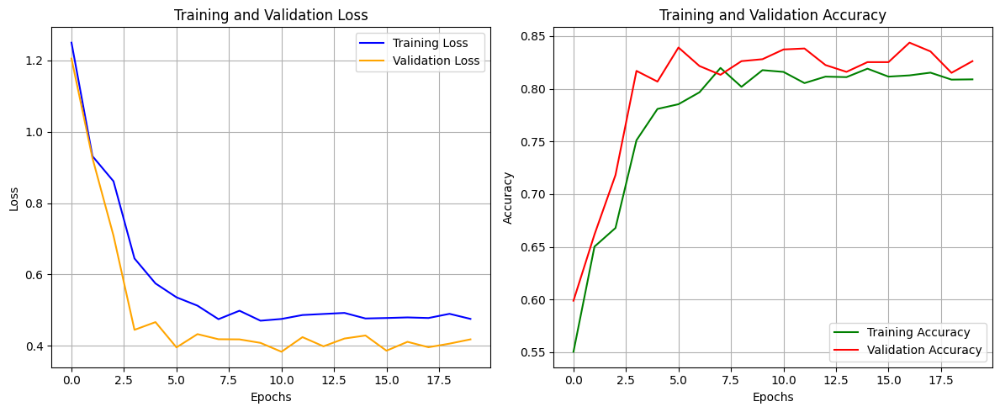

In [23]:
plot_losses_and_accuracies(train_losses,val_losses, train_accuracies, val_accuracies)

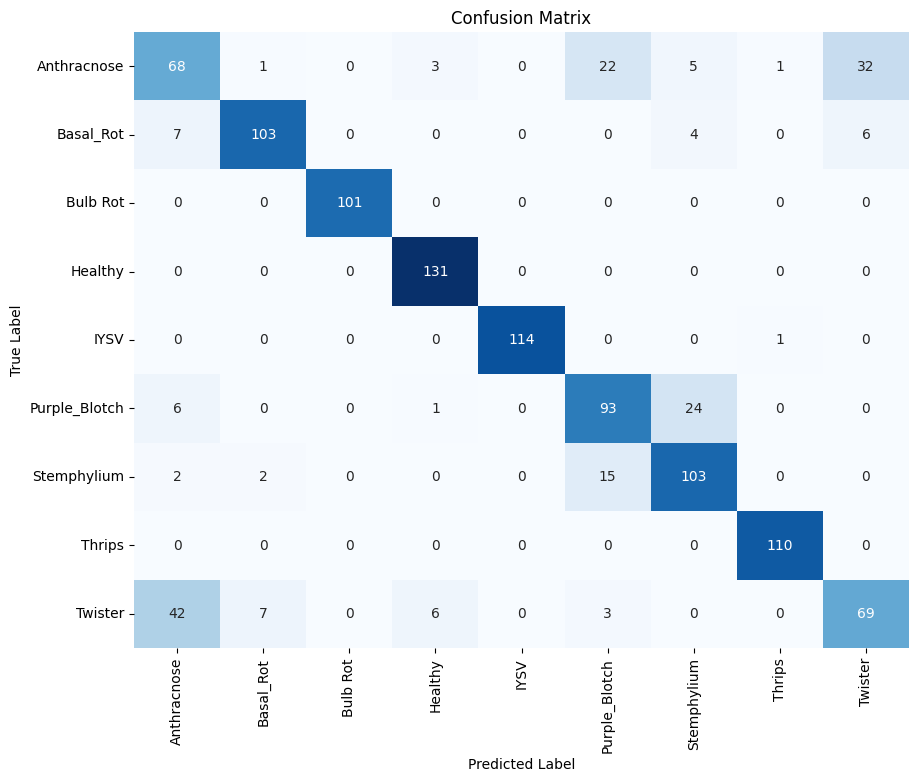

In [24]:
val_labels, val_preds = evaluate_model(model_ft, dataloaders['val'])
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(val_labels, val_preds)
cm_display = plot_confusion_matrix(cm,class_names )


Accuracy for Anthracnose: 0.5152
Accuracy for Basal_Rot: 0.8583
Accuracy for Bulb Rot: 1.0000
Accuracy for Healthy: 1.0000
Accuracy for IYSV: 0.9913
Accuracy for Purple_Blotch: 0.7500
Accuracy for Stemphylium: 0.8443
Accuracy for Thrips: 1.0000
Accuracy for Twister: 0.5433


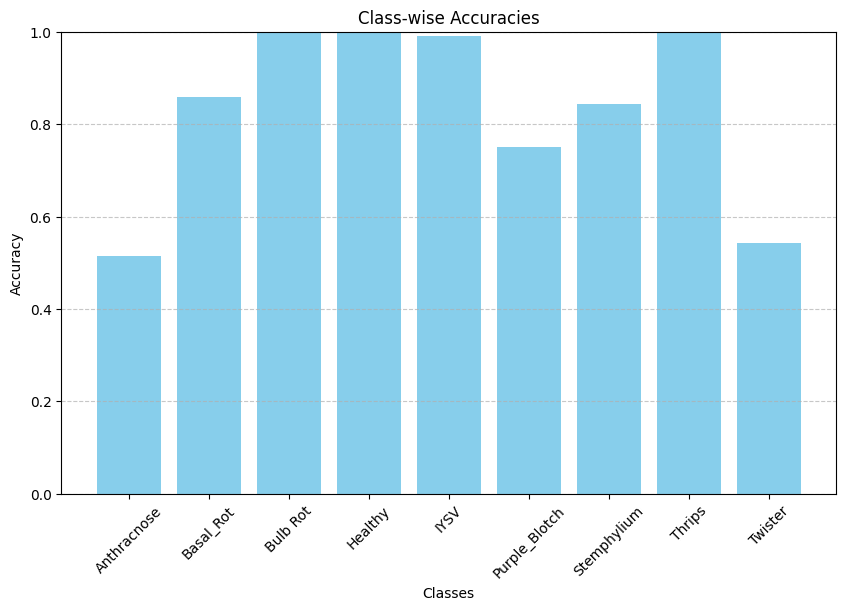

Overall Accuracy: 0.8244


In [ ]:

class_accuracies = cm.diagonal() / cm.sum(axis=1)
for i, class_name in enumerate(class_names):
    print(f'Accuracy for {class_name}: {class_accuracies[i]:.4f}')


plt.figure(figsize=(10, 6))
plt.bar(class_names, class_accuracies, color='skyblue')
plt.xlabel('Classes')
plt.ylabel('Accuracy')
plt.title('Class-wise Accuracies')
plt.xticks(rotation=45)
plt.ylim(0, 1) 
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

total_correct = cm.diagonal().sum()
total_samples = cm.sum()
overall_accuracy = total_correct / total_samples

print(f'Overall Accuracy: {overall_accuracy:.4f}')